In [1]:
using Plots
using DSP
using FFTW

In [2]:
samp_rate = 2e6  #hz
prf = 10  #Hz
τ = 0.05;
β = 250e3; #Pulse Bandwidth
repetitions = 3;

In [3]:
function single_pulse(samp_rate, prf, τ, β; envelope_type="Rectangular", pulse_type="Increasing")
    prt = 1/prf;
    t = 1/samp_rate:1/samp_rate:prt;

    if envelope_type == "Rectangular"
        a = ones(length(t));
        if(length(a) > τ * samp_rate)
            a[Int(τ*samp_rate):end] .= 0;
        end
    elseif envelope_type == "Gaussian"
        a = exp.((-t.^2)/(τ^2)) #Gaussian
    end

    if pulse_type == "Increasing"
        pulse = a.*exp.(im*π*(β/τ)*t.^2)
    elseif pulse_type == "Decreasing"
        pulse = a.*exp.(-im*π*β/τ*(t.^2 - 2*τ.*t))
    end

    return t, pulse;
end


single_pulse (generic function with 1 method)

## Generate Pulse Train

In [4]:
pulse = Array{ComplexF64}(undef,Int(round(1/prf * repetitions * samp_rate)));
t, p = single_pulse(samp_rate, prf, τ, β);

for i in 0:repetitions-1
    idx = i*length(t)
    pulse[idx+1:idx+length(t)] = p;
end

t = 1/samp_rate:1/samp_rate:1/prf*repetitions;


In [6]:
plot(t, abs.(pulse), xguide="Time", yguide="Maginitude", title="Pulse Power Envelope")

In [7]:
plot(t,imag(pulse),xlim=(0,0.005))

In [8]:
plot(t,real(pulse), xlim=(0,0.005))

In [9]:
plot(LinRange(-samp_rate/2, samp_rate/2, length(pulse)), real(fftshift(fft(pulse))))

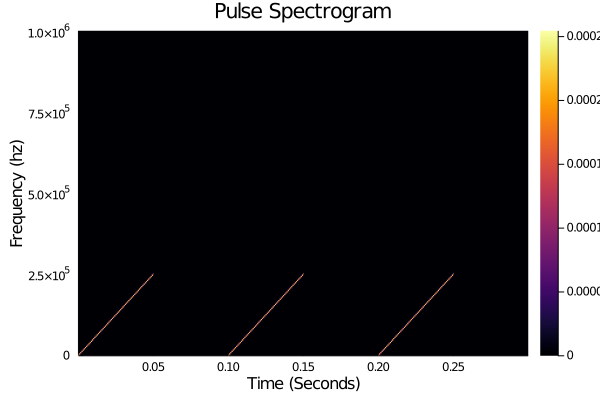

In [10]:
fft_size = 512;
spec = spectrogram((pulse), fft_size; fs=samp_rate);
heatmap(spec.time, LinRange(0,samp_rate/2, Int(fft_size/2)), spec.power[begin:Int(fft_size/2) , :], xguide="Time (Seconds)", yguide="Frequency (hz)", title="Pulse Spectrogram")

In [11]:
Threads.nthreads()

12